# Libraries

In [1]:
import numpy as np
import pandas as pd
import networkx as nx

import colorsys

def pseudocolor(val):
    h = (1.0 - val) * 120 / 360
    r, g, b = colorsys.hsv_to_rgb(h, 1., 1.)
    return r * 255, g * 255, b * 255

# London's tube graph

## Full graph

In [2]:
%matplotlib inline

import matplotlib.pyplot as plt
from collections import Counter
from bokeh.plotting import figure, show
from bokeh.resources import CDN
from bokeh.io import output_notebook
output_notebook( resources=CDN )

pd.set_option('max_colwidth', 200)

Loading BokehJS ...

In [3]:
import pickle as pkl

# London's tube graph
oystergraph = nx.read_gpickle("Data/London.gpickle")

# Collections of locations of the London's tube stations: longitude, latitude
with open('Data/locations.pickle', 'rb') as handle:
    locations = pkl.load(handle)
    
# Centrality of each station with nx.degree_centrality(...)
with open('Data/centrality.pickle', 'rb') as handle:
    centrality = pkl.load(handle)

In [4]:
pkl_file = open('Data/names_dictionary.pkl', 'rb')

names_dictionary = pkl.load(pkl_file)

F = names_dictionary["F"]
Stations_full = names_dictionary["Stations_full"]
Stations = names_dictionary["Stations"]

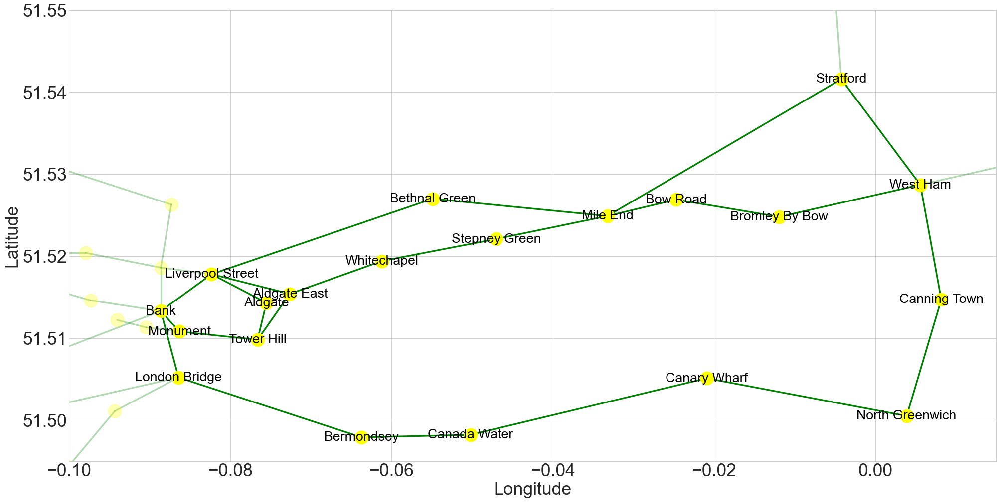

In [5]:
plt.style.use('seaborn-whitegrid')

fig, (london ) = plt.subplots(nrows=1, ncols=1, dpi=80, figsize=(30, 15), sharey=True)

london.set_xlabel('Longitude', fontsize=32)
london.set_ylabel('Latitude', fontsize=32)
london.set_xlim([-0.100, 0.015])
london.set_ylim([51.495, 51.55])



#london.set_title("London's tube network", fontsize=32)

london.xaxis.set_tick_params(labelsize=32)
london.yaxis.set_tick_params(labelsize=32)

for edge in oystergraph.edges():
    
    if (edge[0] in oystergraph.nodes()) & (edge[1] in oystergraph.nodes()):
        x= [locations[pt][0] for pt in edge]
        y= [locations[pt][1] for pt in edge]
    
    if (edge[0] in Stations.values()) & (edge[1] in Stations.values()):
        london.plot(x,y, color='green',linewidth=3)
    else:
        london.plot(x,y, color='green',linewidth=3, alpha = 0.3)


for node in oystergraph.nodes():
    x = [locations[node][0]]
    y = [locations[node][1]]
    size = [centrality[node]]
    
    
    if node in Stations.values():
        london.plot(x, y, marker ='o', markersize= 24, color= 'yellow')
        london.text(x[0], y[0], s= str(node), fontsize = 24, horizontalalignment='center', verticalalignment='center', color='black',rotation=0)    

    else:
        london.plot(x, y, marker ='o', markersize= 24, color= 'yellow', alpha = 0.3)
        
fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\londonnet.pdf', format='pdf', dpi = 200, bbox_inches='tight')
        

## Subgraph to analyse

In [6]:
lanepart = nx.shortest_path(oystergraph, 'West Ham', 'Bank') 
lanepart = lanepart + nx.shortest_path(oystergraph, 'Canning Town', 'London Bridge') 
lanepart = lanepart + nx.shortest_path(oystergraph, 'Mile End', 'Whitechapel')
lanepart = lanepart + ["Aldgate", "Aldgate East", "Tower Hill", "Monument", "Stratford", "Bow Road", "Bromley By Bow"]

In [7]:
lanepartgraph = oystergraph.subgraph(lanepart)

In [8]:
from bokeh.plotting import figure, show, output_file
from bokeh.models import Title

p = figure(
    x_range = (-0.1,.03),
    y_range = (51.49,51.545),
    height= 500,
    width= 900,
    y_axis_label='Latitude',
    x_axis_label='Longitude'
)
for edge in lanepartgraph.edges():
    p.line( 
        x= [locations[pt][0] for pt in edge],
        y= [locations[pt][1] for pt in edge],
    )

for node in lanepartgraph.nodes():
    x = [locations[node][0]]
    y = [locations[node][1]]
    p.circle(
        x, y, 
        radius = .0005+.0025*centrality[node], 
        fill_color = pseudocolor(centrality[node]), 
        line_alpha=0)
    
    p.text(
        x, y, 
        text = {'value':node}, 
        text_font_size = str(4+min(centrality[node] * 8, 10)) + "pt", 
        text_align='center',
        text_font_style='bold',
        alpha= 0.5+centrality[node])   
    

p.xaxis.visible = False
p.yaxis.visible = False
p.add_layout(Title(text="London's tube", align="center"), "above")

show(p)

## Preliminaries

Load the unique correspondence between factors and stations.

In [9]:
pkl_file = open('Data/names_dictionary.pkl', 'rb')

names_dictionary = pkl.load(pkl_file)

F = names_dictionary["F"]
Stations_full = names_dictionary["Stations_full"]
Stations = names_dictionary["Stations"]

Create the factor graph. 

In [10]:
lanepartBipartite =  nx.Graph()

count = 0
for e1, e2 in lanepartgraph.edges:

    zeros = ""
    for i in range(len(str(len(lanepartgraph.edges)))-len(str(count))):
        zeros = zeros + "0"
        
    lanepartBipartite.add_nodes_from(["V"+zeros+str(count)], bipartite=0)
    
    if (e1 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e1+"-Inflow"]], bipartite=1)
        
    if (e2 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e2+"-Outflow"]], bipartite=1)
        
    
    lanepartBipartite.add_edges_from([(F[e1+"-Inflow"],"V"+zeros+str(count))])
    lanepartBipartite.add_edges_from([("V"+zeros+str(count), F[e2+"-Outflow"])])
    
    count = count +1

In [11]:
for e1, e2 in lanepartgraph.edges:

    zeros = ""
    for i in range(len(str(len(lanepartgraph.edges)))-len(str(count))):
        zeros = zeros + "0"
        
    lanepartBipartite.add_nodes_from(["V"+zeros+str(count)], bipartite=0)
    
    if (e1 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e1+"-Outflow"]], bipartite=1)
        
    if (e2 in lanepartBipartite.nodes)==False:
        lanepartBipartite.add_nodes_from([F[e2+"-Inflow"]], bipartite=1)
        
    
    lanepartBipartite.add_edges_from([(F[e2+"-Inflow"],"V"+zeros+str(count))])
    lanepartBipartite.add_edges_from([("V"+zeros+str(count), F[e1+"-Outflow"])])
    
    count = count +1    

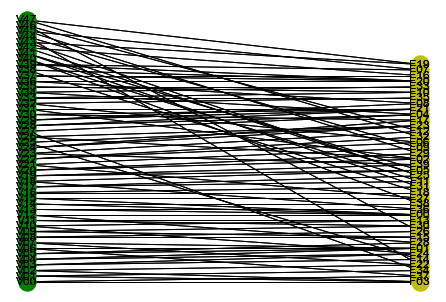

In [12]:
# reognize the different nodes
top_nodes = []
bottom_nodes = []

for item, bipartite in lanepartBipartite.nodes(data=True):
#     print(bipartite)
    if bipartite['bipartite']==0:
        top_nodes.append(item)
    else:
        bottom_nodes.append(item)

pos = dict()
pos.update( (n, (1, i)) for i, n in enumerate((np.array(top_nodes, dtype = '<U8'))) ) # put nodes from X at x=1
pos.update( (n, (2, i)) for i, n in enumerate((np.array(bottom_nodes, dtype = '<U8'))) ) # put nodes from Y at x=2
nx.draw(lanepartBipartite, pos, nodelist= top_nodes, node_color='g',  with_labels = True)
nx.draw(lanepartBipartite, pos, nodelist= bottom_nodes, node_color='y',  with_labels = True)
plt.show()

# Training

In [13]:
YT_train = np.load("Data/YT_train.npy")
YT_test  = np.load("Data/YT_test.npy")


Here we show how we trained the LSTM, the trained LSTM is available in the "Data" folder. The training using tensorflow can be skipped but we still need to convert the data in a LSTM readable format.

In [14]:
import numpy
import matplotlib.pyplot as plt
import pandas
import math
# import tensorflow as tf
# import tensorflow.keras as keras
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense
# from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

# physical_devices = tf.config.list_physical_devices('GPU') 
# tf.config.experimental.set_memory_growth(physical_devices[0], True)

# normalize the dataset
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(YT_train)

# convert an array of values into a dataset matrix
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back):
        a = dataset[i:(i+look_back), :]
        dataX.append(a)
        dataY.append(dataset[i + look_back, :])
    return numpy.array(dataX), numpy.array(dataY)

# reshape into X=t and Y=t+1
look_back = 1
trainX, trainY = create_dataset(dataset, look_back)

# normalize the dataset
scaler_test = MinMaxScaler(feature_range=(0, 1))
dataset_test = scaler.fit_transform(YT_test)

# reshape into X=t and Y=t+1
testX, testY = create_dataset(dataset_test, look_back)

Create and fit the LSTM, the hidden units are chosen by the user.

In [15]:
# units = 40
# LSTM_alg = {}

# for i in range(100):
#     print("####################################")
#     print("Iter ", i)
#     print("####################################")
#     LSTM_alg[str(i)] = Sequential()
#     LSTM_alg[str(i)].add(LSTM(10, input_shape=(1, units)))
#     LSTM_alg[str(i)].add(Dense(units))
#     LSTM_alg[str(i)].compile(loss='mean_squared_error', optimizer='adam')
#     LSTM_alg[str(i)].fit(trainX, trainY, epochs=100, batch_size=1, verbose=2)

Save the results.

In [16]:
# for LSTM_key in LSTM_alg:
#     path = 'LSTM-trained\LSTM'+LSTM_key
#     LSTM_alg[LSTM_key].save(path)


Load the LSTM, here we load only 10 out of the 100 trained LSTMs.

In [18]:
from tensorflow import keras

LSTM_alg = {}

for LSTM_key in range(10):
    print(LSTM_key)
    path = 'Data\LSTM-trained\LSTM'+str(LSTM_key)
    LSTM_alg[str(LSTM_key)] = keras.models.load_model(path)

0
1
2
3
4
5
6
7
8
9


## Prediction on the test data

In [19]:
testScore_RMSE = []
testScore_abs  = []

testPredict_list = []

for i in range(10):
    starting_time = 0
    ending_time = 290

    # make predictions
    testPredict = LSTM_alg[str(i)].predict(testX[starting_time:ending_time,:,:])

    # invert predictions
    testPredict = scaler.inverse_transform(testPredict)
    testY_inv = scaler.inverse_transform(testY[starting_time:ending_time])
    
    testPredict_list.append(testPredict)

    # calculate root mean squared error
    testScore_RMSE_i = np.sqrt( np.mean((testY_inv-testPredict)**2 ))
    testScore_abs_i = np.mean( np.abs(testY_inv-testPredict))
    # testScore_lhalf = np.square(np.mean( np.sqrt(np.abs(testY_inv-testPredict))))
    
    testScore_RMSE.append(testScore_RMSE_i)
    testScore_abs.append(testScore_abs_i)

Report all stations

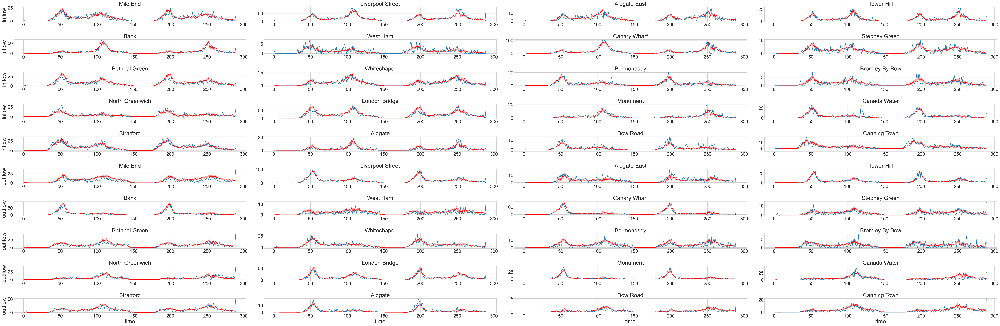

In [20]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
                
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)
        
        j = j+1

fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_LSTMprediction_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

Report a subset of the stations.

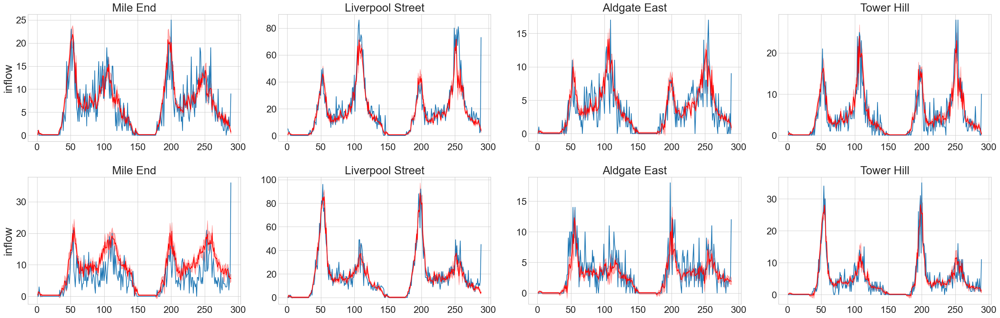

In [21]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=100, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
                
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)
        
        j = j+1

fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_LSTMprediction.pdf', format='pdf', dpi = 100, bbox_inches='tight')

In [22]:
print("RMSE "+ str(round(np.mean(testScore_RMSE), 3))+"+/-"+str(round(np.std(testScore_RMSE), 3)) )
print("ABS-metric "+ str(round(np.mean(testScore_abs), 3))+"+/-"+str(round(np.std(testScore_abs), 3)) )

RMSE 4.703+/-0.172
ABS-metric 2.442+/-0.074


## Prediction on missing data

### Window with decreasing flow

Here we remove the data in a window with decreasing flows.

In [23]:
testScore_RMSE = []
testScore_abs  = []

testPredict_list = []

for i in range(10):
#     print(i)
    start_missing_data_time = 130
    number_missing_data = 40
    ending_time=290

    # make predictions
    testPredict =  np.zeros((testX.shape[0], testX.shape[2]))
    testPredict[:start_missing_data_time,:] = LSTM_alg[str(i)].predict(testX[starting_time:start_missing_data_time,:,:])

    for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
        testPredict[time,:] = LSTM_alg[str(i)].predict( testPredict[time-1,:].reshape(1,1,40) )

    testPredict[start_missing_data_time + number_missing_data:ending_time,:] = LSTM_alg[str(i)].predict(testX[start_missing_data_time + number_missing_data:ending_time,:,:])

    # invert predictions
    testPredict_norm = scaler.inverse_transform(testPredict)
    testY_inv = scaler.inverse_transform(testY[:ending_time])
    
    testPredict_list.append(testPredict_norm)

    # calculate root mean squared error
    testScore_RMSE_i = np.sqrt( np.mean((testY_inv-testPredict_norm)**2 ))
    testScore_abs_i = np.mean( np.abs(testY_inv-testPredict_norm) )
    
    testScore_RMSE.append(testScore_RMSE_i)
    testScore_abs.append(testScore_abs_i)

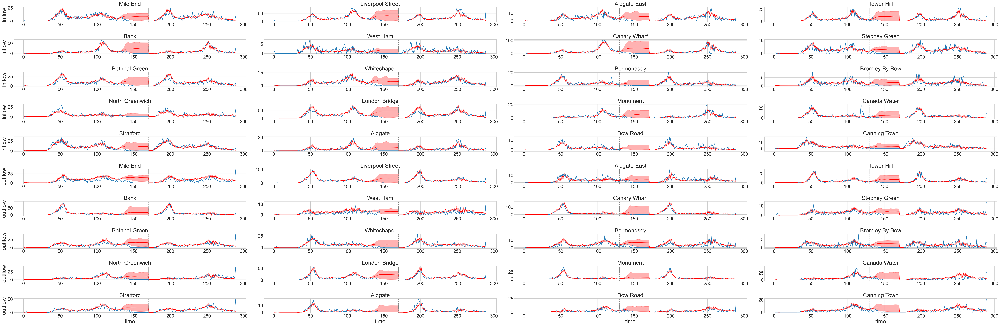

In [24]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_LSTMpredictionmissingnopeak_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

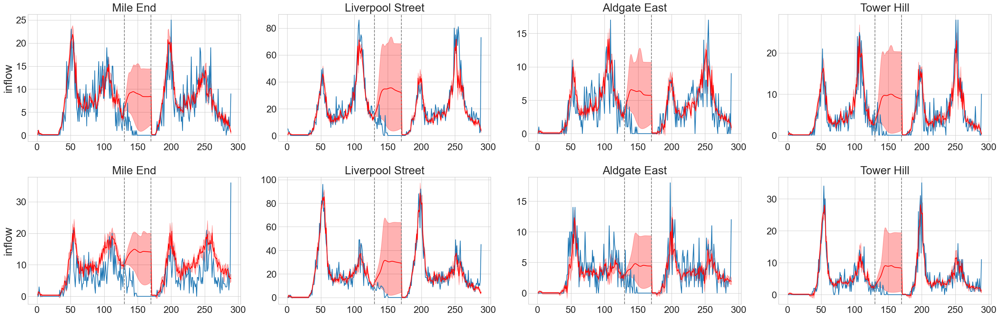

In [25]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=100, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time, testY_inv[:,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_LSTMpredictionmissingnopeak.pdf', format='pdf', dpi = 100, bbox_inches='tight')

In [26]:
print("RMSE "+str(round(np.mean(testScore_RMSE), 3))+"+/-"+str(round(np.std(testScore_RMSE), 3)))
print("ABS-metric "+str(round(np.mean(testScore_abs), 3))+"+/-"+str(round(np.std(testScore_abs), 3)))

RMSE 7.97+/-2.478
ABS-metric 3.733+/-0.79


### Window with peak

Here we remove the data in a window with big flows.

In [27]:
testScore_RMSE = []
testScore_abs  = []

testPredict_list = []

for i in range(10):
    start_missing_data_time = 230
    number_missing_data = 40

    # make predictions
    testPredict =  np.zeros((testX.shape[0], testX.shape[2]))
    testPredict[:start_missing_data_time,:] = LSTM_alg[str(i)].predict(testX[starting_time:start_missing_data_time,:,:])

    for time in range(start_missing_data_time, start_missing_data_time + number_missing_data):
        testPredict[time,:] = LSTM_alg[str(i)].predict( testPredict[time-1,:].reshape(1,1,40) )

    testPredict[start_missing_data_time + number_missing_data:ending_time,:] = LSTM_alg[str(i)].predict(testX[start_missing_data_time + number_missing_data:ending_time,:,:])

    # invert predictions
    testPredict_norm = scaler.inverse_transform(testPredict)
    testY_inv = scaler.inverse_transform(testY[:ending_time])
    
    testPredict_list.append(testPredict_norm)

    # calculate root mean squared error
    testScore_RMSE_i = np.sqrt( np.mean((testY_inv-testPredict_norm)**2 ))
    testScore_abs_i = np.mean( np.abs(testY_inv-testPredict_norm) )
    
    testScore_RMSE.append(testScore_RMSE_i)
    testScore_abs.append(testScore_abs_i)

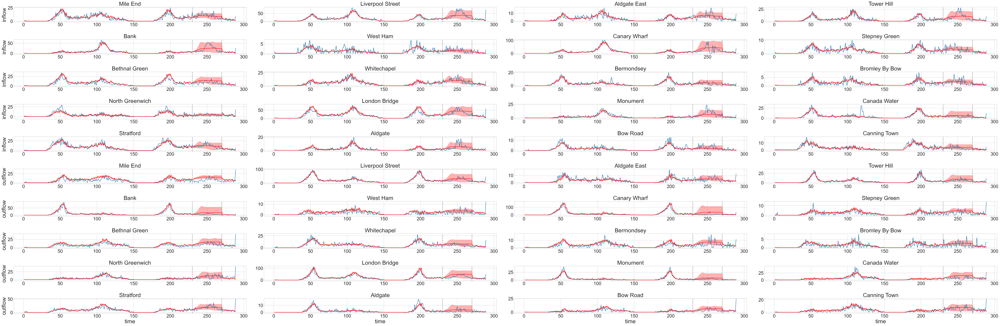

In [28]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(60, 20), dpi=200, facecolor='w', edgecolor='k',nrows=10, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
#     if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time[:ending_time], testY_inv[:ending_time,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Appendix\london_LSTMpredictionmissingwithpeak_complete.pdf', format='pdf', dpi = 200, bbox_inches='tight')

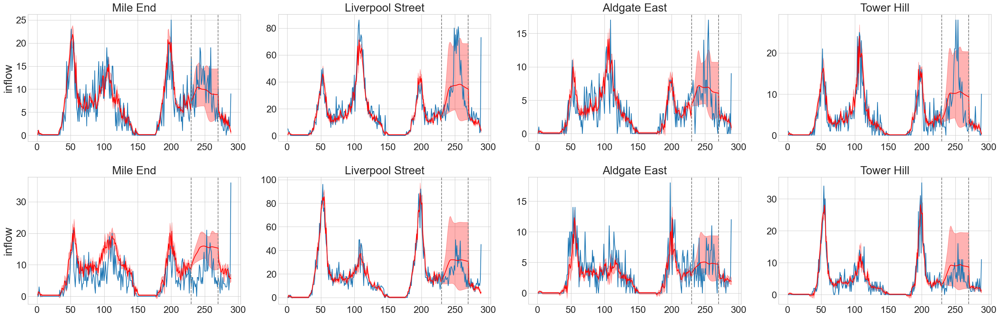

In [29]:
import matplotlib.ticker as ticker

fig, ax = plt.subplots(num=None, figsize=(30, 10), dpi=100, facecolor='w', edgecolor='k',nrows=2, ncols=4)

# plt.setp(ax,  xticks=[0,56,112,168,224], xticklabels= MonTue[np.array([0,56,112,168,224])])
time = np.linspace(1, testY_inv.shape[0], testY_inv.shape[0])

i = 0
j = 0
color = "red"

Y_pred_quant = np.quantile(np.array(testPredict_list), (0.05, 0.5, 0.95), axis = 0)
mean = np.mean(np.array(testPredict_list), axis = 0)

for name in range(0, testPredict.shape[1]):
    
#     print(i, j)
    if name in {0, 1, 2, 3, 20, 21, 22, 23}:
        if j == 4:
            j = 0 
            i = i+1

        if j==0:
            
            if i <5:
                ax[i,j].set_ylabel('inflow',fontsize=24)
            else:
                ax[i,j].set_ylabel('outflow',fontsize=24)
        if i==9:
            ax[i,j].set_xlabel('time',fontsize=24)

        zeros = ""
        for k in range(len(str(testPredict_norm.shape[1]))-len(str(name))):
            zeros = zeros + "0"    


        ax[i,j].set_title(Stations["F"+zeros+str(name)], fontsize=24)    

    #     np.linspace(249, 249+len(Y_dict[name]), len(Y_dict[name])),

        ax[i,j].plot(time[:ending_time], testY_inv[:ending_time,name])

    #     ax[i,j].xaxis.set_tick_params(labelsize=12)

        ax[i,j].plot(time, mean[:, name], color=color) 
        ax[i,j].fill_between(time, Y_pred_quant[0, :, name], Y_pred_quant[2, :, name], alpha = 0.3, color=color ) 
        
        ax[i,j].tick_params(axis='x', labelsize=20) 
        ax[i,j].tick_params(axis='y', labelsize=20)

        ax[i,j].axvline(x=start_missing_data_time,  linestyle="--", color = "grey" )
        ax[i,j].axvline(x=start_missing_data_time+number_missing_data,  linestyle="--", color = "grey")

        j = j+1
    
fig.tight_layout(pad=3.0)
# fig.savefig(r'C:\Users\loren\Dropbox\PhD\Research\GraphFilterandGraphSmoother\Factorial HMM\JMLR\JMLRreviews\jmlr-reviews\Paper\Figures\london_LSTMpredictionmissingwithpeak.pdf', format='pdf', dpi = 100, bbox_inches='tight')

In [30]:
print("RMSE "+str(round(np.mean(testScore_RMSE), 3))+"+/-"+str(round(np.std(testScore_RMSE), 3)))
print("ABS-metric "+str(round(np.mean(testScore_abs), 3))+"+/-"+str(round(np.std(testScore_abs), 3)))

RMSE 6.401+/-1.524
ABS-metric 2.926+/-0.421
